# Crossfit Subreddit Visualizations

1. Load Data
2. Simple EDA
3. Wordclouds
3. TSNE

In [51]:
import pandas as pd
import pickle
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

In [60]:
from reddit import plot_tsne
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## 1. Load Data

In [24]:
df_praw = pickle.load(open('df_praw_9topics.pkl', 'rb'))

In [25]:
df_praw.head()

,author,id,num_comments,score,url,upvote_ratio,time,full_text,media,topic
168,wats8976,7lzfw,0,3,https://www.reddit.com/r/crossfit/comments/7lz...,NaN,2008-12-27 23:24:43,whats your favorite crossfit video,none,1
150,jerodhoffman,7ucsy,1,1,http://thefitnessrevelation.com/2008/08/22/fun...,NaN,2009-02-02 21:48:29,reasons functional training leads to better ...,NaN,0
148,[deleted],7ul3a,6,4,https://www.reddit.com/r/crossfit/comments/7ul...,NaN,2009-02-03 18:27:48,am i the only one who finds the pullup require...,none,0
147,jerodhoffman,7ulx9,0,0,http://thefitnessrevelation.com/2009/01/29/sav...,NaN,2009-02-03 19:53:06,save time and money homegrown fitness the fi...,NaN,8
146,jerodhoffman,7vvku,0,1,http://thefitnessrevelation.com/2009/02/08/ket...,NaN,2009-02-09 02:09:59,kettlebell trainingunlock mental toughness and...,NaN,0


In [29]:
topic_names = ['Crossfit Feels', 'Why I love Crossfit', 'Personal Records', 'Crossfit Games', 'Shoes', 'Workouts', 'WODs', 'Crossfit Open', 'Gym Advice']

## 2. Simple Exploratory Data Analysis

Most active topic by number of comments

<function matplotlib.pyplot.show(*args, **kw)>

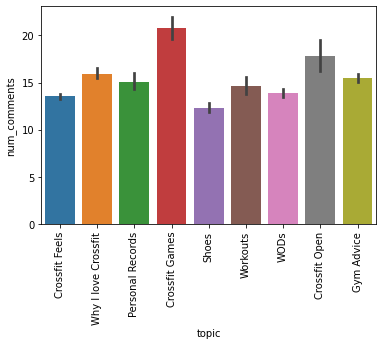

In [33]:
data = df_praw[['num_comments', 'score', 'topic']]

ax = sns.barplot(x=data['topic'], y=data['num_comments'])

ax.set_xticklabels(topic_names, rotation=90)
plt.show

Most popular topic by score

<function matplotlib.pyplot.show(*args, **kw)>

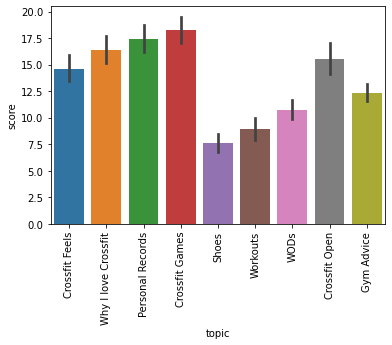

In [34]:
ax = sns.barplot(x=data['topic'], y=data['score'])

ax.set_xticklabels(topic_names, rotation=90)
plt.show

In [ ]:
#export data to CSV for viz in tableau
df_praw.to_csv("cf_all_9topics.csv")

## 3. Wordclouds

In [36]:
#add stop words
from sklearn.feature_extraction import text 

addl_stop_words = ['im', 'ive','just', 'nt', 've', 'like', 'want', 'year', 'good', 'really', 'think', 'know', 'try', 'work', 'new', 'today', 'week', 'thing', 'cf', 'time', 'thank', 'rx', 'start', 'help', 'home']
stop_words = text.ENGLISH_STOP_WORDS.union(addl_stop_words)

In [37]:
from wordcloud import WordCloud

wc = WordCloud(stopwords=stop_words, background_color="white", colormap="Dark2",
               max_font_size=150, random_state=42)

Wordcloud for all corpus

In [39]:
# combine all corpus into single text
all_text = ' '.join(list(df_praw.full_text.values))

# generate wordcloud
wc.generate(all_text)

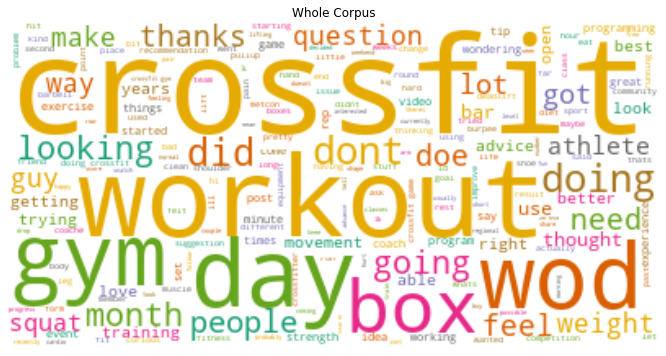

In [41]:
plt.figure(figsize=(16, 6))
plt.imshow(wc, interpolation="bilinear")

plt.axis("off")
plt.title('Whole Corpus')
    
plt.show()

Words in each topic

In [42]:
#combine text of each topic
topic_text = df_praw.groupby('topic')['full_text'].apply(lambda x: ' '.join(x)).reset_index()

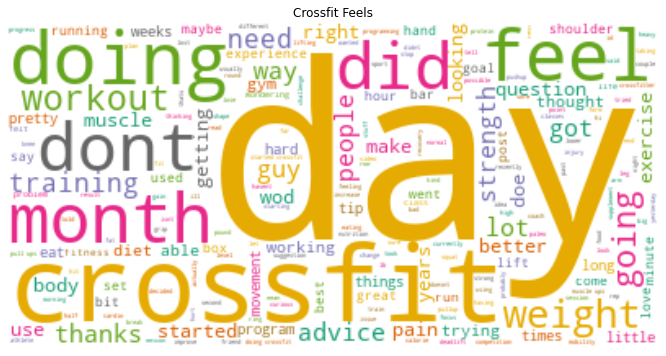

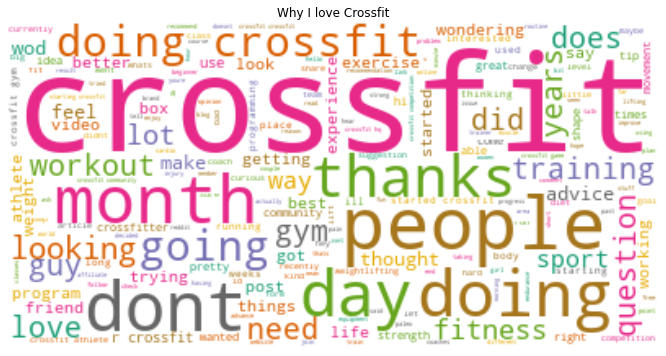

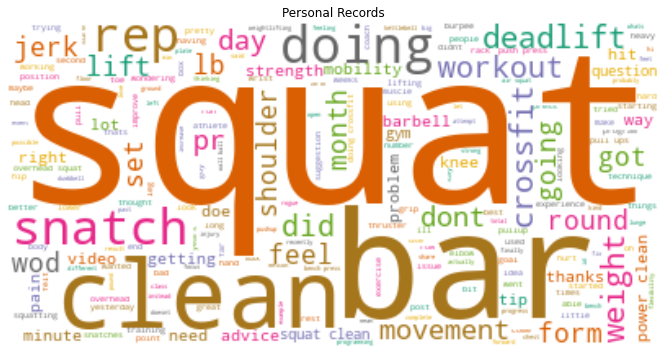

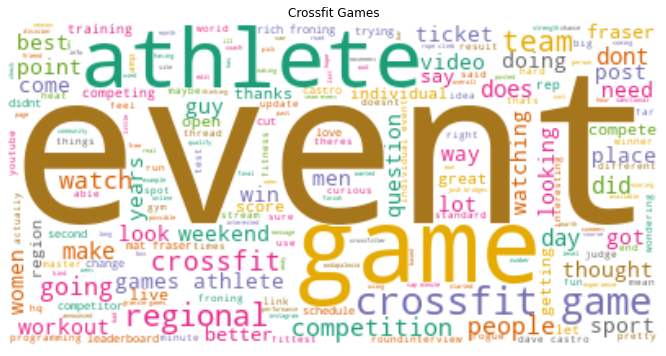

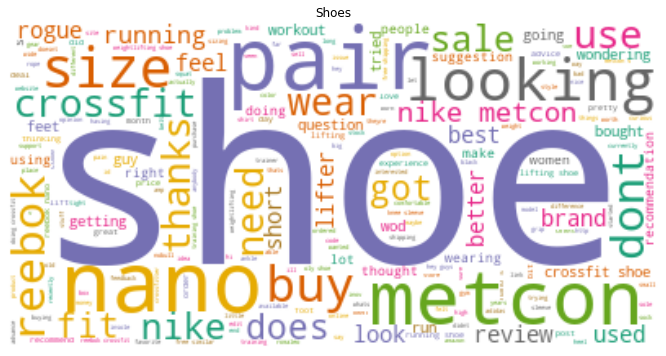

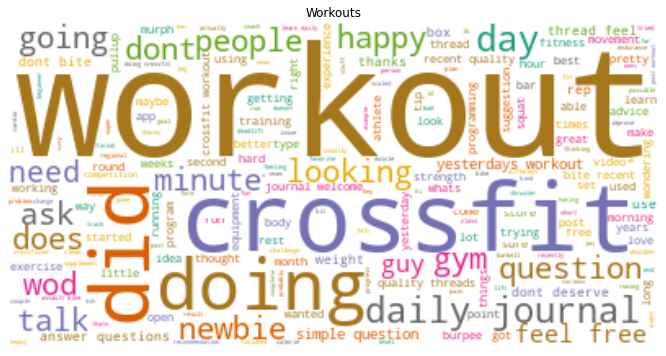

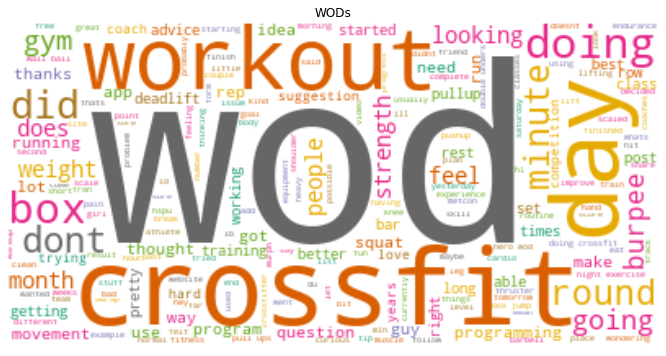

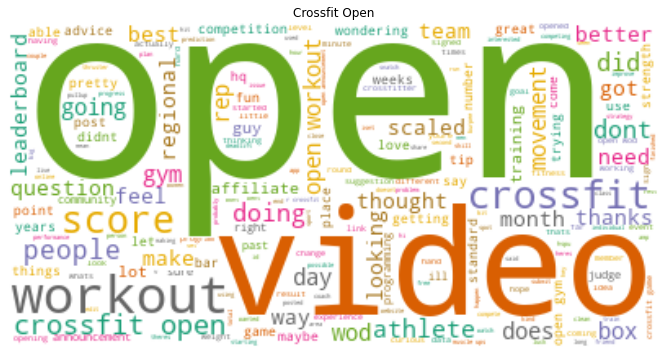

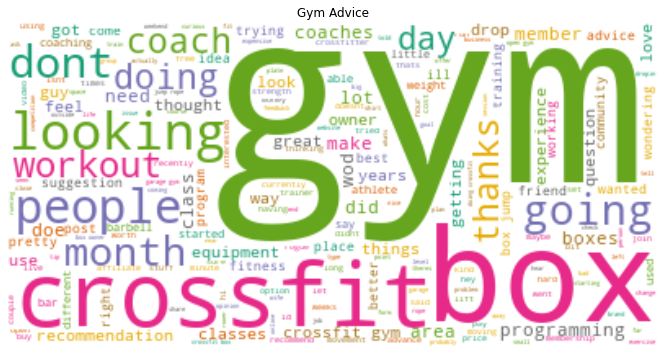

In [43]:
# Create subplots for each topic
for index, topic in enumerate(topic_text.topic):
    wc.generate(topic_text.full_text[topic])
    
    # plt.subplot(3, 3, index+1)
    plt.figure(figsize=(16, 6))

    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title(topic_names[index])
    
plt.show()

## 4. TSNE
Compress 9 components to 2-D space for visualization of documents/topics

In [45]:
# load doc_topic from topic modeling
doc_topic = pickle.load(open('doc_topic.pkl', 'rb'))

# assign document to topic with max distribution
doc_cluster = doc_topic.argmax(axis = 1)

In [46]:
plt.style.use("seaborn")

from sklearn.manifold import TSNE

In [47]:
model = TSNE(n_components=2, random_state=0,verbose=0, metric='cosine')
low_data = model.fit_transform(doc_topic)

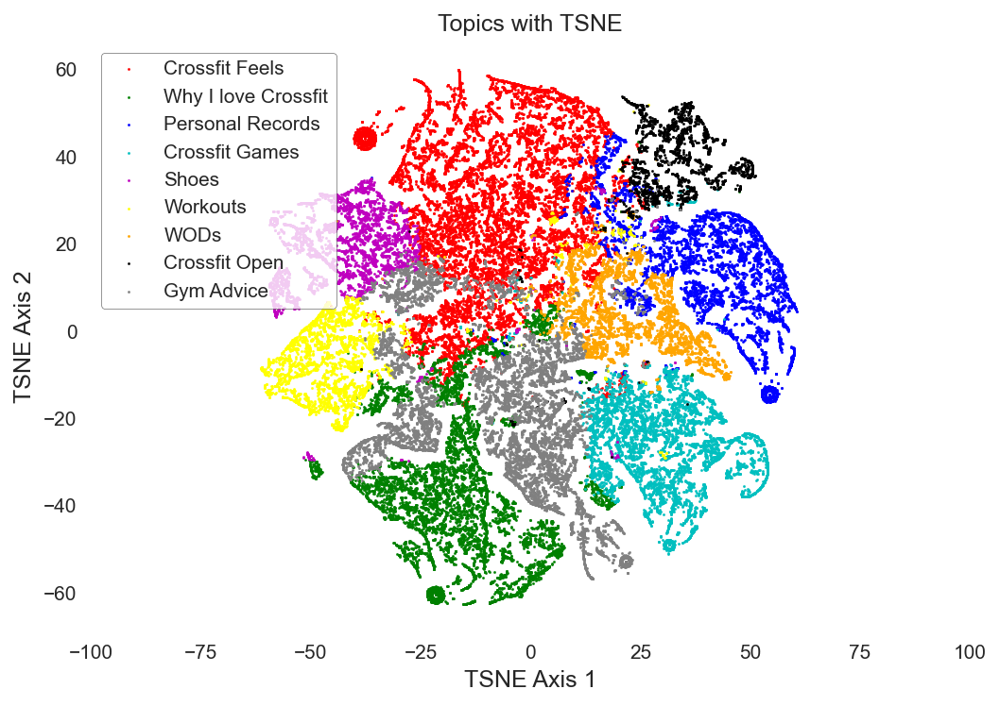

In [61]:
# plot topics with TSNE
plot_tsne(doc_cluster, low_data, topic_names)

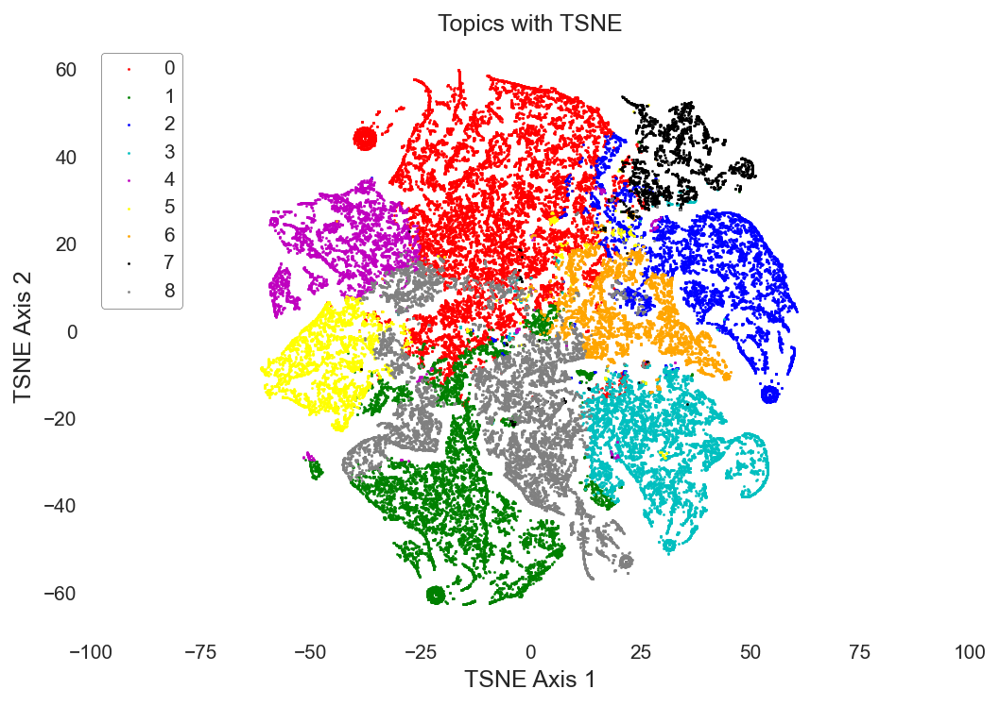

In [62]:
# plot again without topic labels
plot_tsne(doc_cluster, low_data)